# **Preparing excel file**

In [ ]:
import pandas as pd
import numpy as np
import missingno as msno
import matplotlib.pyplot as plt
import seaborn as sns

In [ ]:
%matplotlib inline

In [ ]:
from google.colab import drive

drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
df = pd.read_csv('/content/drive/MyDrive/Article/Excel_finished/finished_excel.csv')

In [ ]:
df.to_csv('finished_excel.csv')

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 253 entries, 0 to 252
Data columns (total 26 columns):
 #   Column                           Non-Null Count  Dtype  
---  ------                           --------------  -----  
 0   Unnamed: 0                       253 non-null    int64  
 1   NP                               21 non-null     object 
 2   Name                             240 non-null    object 
 3   Coating                          253 non-null    float64
 4   NP_Synthesis                     253 non-null    object 
 5   NP size_min (nm)                 253 non-null    float64
 6   NP size_max (nm)                 253 non-null    float64
 7   NP size_avg (nm)                 253 non-null    float64
 8   shape                            253 non-null    object 
 9   method                           253 non-null    object 
 10  Bacteria                         253 non-null    object 
 11  Strain                           122 non-null    object 
 12  Concentration (μg/ml) 

In [ ]:
df.head()

,Unnamed: 0,NP,Name,Coating,NP_Synthesis,NP size_min (nm),NP size_max (nm),NP size_avg (nm),shape,method,...,doi,time (hr),MDR,Solvent for extract,"Temperature for extract, C","Duration preparing extract, min",Precursor of NP,Concentration of precursor (mM),hydrodynamic diameter,pH during synthesis
0,0,Ag,FAgNPs,0.0,green synthesis using fig,4.0,36.0,20.0,spherical,ZOI,...,https://doi.org/10.1016/j.jksus.2023.102959,18.0,1.0,water,100.0,15.0,AgNO3,5.0,33.79,NaN
1,1,Ag,FAgNPs,0.0,green synthesis using fig,4.0,36.0,20.0,spherical,ZOI,...,https://doi.org/10.1016/j.jksus.2023.102959,18.0,0.0,water,100.0,15.0,AgNO3,5.0,33.79,NaN
2,2,Ag,FAgNPs,0.0,green synthesis using fig,4.0,36.0,20.0,spherical,ZOI,...,https://doi.org/10.1016/j.jksus.2023.102959,18.0,0.0,water,100.0,15.0,AgNO3,5.0,33.79,NaN
3,3,Ag,FAgNPs,0.0,green synthesis using fig,4.0,36.0,20.0,spherical,ZOI,...,https://doi.org/10.1016/j.jksus.2023.102959,18.0,0.0,water,100.0,15.0,AgNO3,5.0,33.79,NaN
4,4,Ag,MAgNPs,0.0,green synthesis using myrrh,6.0,30.0,18.0,spherical,ZOI,...,https://doi.org/10.1016/j.jksus.2023.102959,18.0,1.0,water,100.0,15.0,AgNO3,5.0,31.63,NaN


In [ ]:
df['NP_Synthesis'] = df['NP_Synthesis'].str.lower()

In [ ]:
df['NP_Synthesis'].unique(), len(df['NP_Synthesis'].unique())

(array(['green synthesis using fig ', 'green synthesis using myrrh',
        'green synthesis using spirulina sp',
        'green synthesis using s. subsalsa',
        'green synthesis using actinobacteria strain hgg16n',
        'green synthesis using origanum ehrenbergii',
        'green synthesis using phyllanthus niruri ',
        'green synthesis using phoenix dactylifera seed',
        'green synthesis using ricinus communis',
        'green green synthesis using commiphora myrrh',
        'green synthesis using melissa officinalis',
        'green synthesis using acacia nilotica',
        'green synthesis using fungal filtrate the heavy metal resistant strain amycolatopsis tucumanensis',
        'green synthesis using murraya koenigii', 'gamma irradiation',
        'green synthesis using lignosus rhinocerotis',
        'green synthesis using streptomyces chiangmaiensis',
        'chemical synthesis using sodium borohydride',
        'green synthesis using pisum sativum l.',
    

In [ ]:
def changing_biosynthesis(x):
  if 'biosynthesis' in x:
    return x.replace('biosynthesis', 'green synthesis')
  else:
    return x

In [ ]:
df['NP_Synthesis'] = df['NP_Synthesis'].apply(changing_biosynthesis)

In [ ]:
df['NP_Synthesis'].unique(), len(df['NP_Synthesis'].unique())

(array(['green synthesis using fig ', 'green synthesis using myrrh',
        'green synthesis using spirulina sp',
        'green synthesis using s. subsalsa',
        'green synthesis using actinobacteria strain hgg16n',
        'green synthesis using origanum ehrenbergii',
        'green synthesis using phyllanthus niruri ',
        'green synthesis using phoenix dactylifera seed',
        'green synthesis using ricinus communis',
        'green green synthesis using commiphora myrrh',
        'green synthesis using melissa officinalis',
        'green synthesis using acacia nilotica',
        'green synthesis using fungal filtrate the heavy metal resistant strain amycolatopsis tucumanensis',
        'green synthesis using murraya koenigii', 'gamma irradiation',
        'green synthesis using lignosus rhinocerotis',
        'green synthesis using streptomyces chiangmaiensis',
        'chemical synthesis using sodium borohydride',
        'green synthesis using pisum sativum l.',
    

In [ ]:
df['Coating'] = df['Coating'].fillna(0)

In [ ]:
df['Coating'].isnull().sum()

0

In [ ]:
df['Coating'].isnull().sum()

0

In [ ]:
df['ZOI']

,ZOI
0,24.67
1,NaN
2,8.00
3,14.67
4,23.00
...,...
248,13.44
249,13.06
250,14.06
251,12.28


In [ ]:
df['ZOI'].replace('-', np.nan, inplace = True)

In [ ]:
df['ZOI'].unique()

array([24.67,   nan,  8.  , 14.67, 23.  , 19.  , 18.  , 17.  ,  6.  ,
       10.  ,  7.  ,  9.  ,  8.3 ,  7.3 ,  9.3 , 10.3 ,  8.6 , 11.  ,
       12.  , 11.6 , 11.3 , 14.  , 14.3 , 12.3 , 13.  , 16.  , 15.3 ,
       13.3 , 22.  , 30.  , 15.  , 24.  , 20.5 , 16.5 , 17.5 ,  3.  ,
       45.  , 59.  , 51.  ,  5.  ,  6.5 , 15.5 , 12.5 , 20.  , 18.5 ,
       21.  , 40.  , 25.  , 33.  , 11.7 , 20.3 , 12.6 ,  4.  ,  2.  ,
        3.5 ,  8.5 ,  2.5 , 26.  , 28.  , 37.  , 27.  , 35.  , 32.  ,
       16.28, 14.42, 15.56, 13.82, 12.98, 15.42, 13.44, 13.06, 14.06,
       12.28, 12.76])

In [ ]:
df['MDR'] = df['MDR'].fillna(0)

In [ ]:
df['MDR'].unique()

array([1., 0.])

In [ ]:
df['Bacteria'] = df['Bacteria'].replace(['A. baumannii'], 'Acinetobacter baumannii')

In [ ]:
df.columns

Index(['Unnamed: 0', 'NP', 'Name', 'Coating', 'NP_Synthesis',
       'NP size_min (nm)', 'NP size_max (nm)', 'NP size_avg (nm)', 'shape',
       'method', 'Bacteria', 'Strain ', 'Concentration (μg/ml)', 'ZOI',
       'Zeta_potential (mV)', 'reference', 'doi', 'time (hr)', 'MDR',
       'Solvent for extract ', 'Temperature for extract, C',
       'Duration preparing extract, min', 'Precursor of NP',
       'Concentration of precursor (mM)', 'hydrodynamic diameter',
       'pH during synthesis'],
      dtype='object')

In [ ]:
df.to_csv('finished_excel.csv')

# **Data preprocessing**

In [ ]:
df = pd.read_csv('/content/finished_excel.csv')

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 253 entries, 0 to 252
Data columns (total 27 columns):
 #   Column                           Non-Null Count  Dtype  
---  ------                           --------------  -----  
 0   Unnamed: 0.1                     253 non-null    int64  
 1   Unnamed: 0                       253 non-null    int64  
 2   NP                               21 non-null     object 
 3   Name                             240 non-null    object 
 4   Coating                          253 non-null    float64
 5   NP_Synthesis                     253 non-null    object 
 6   NP size_min (nm)                 253 non-null    float64
 7   NP size_max (nm)                 253 non-null    float64
 8   NP size_avg (nm)                 253 non-null    float64
 9   shape                            253 non-null    object 
 10  method                           253 non-null    object 
 11  Bacteria                         253 non-null    object 
 12  Strain                

In [ ]:
df = df.drop(columns = ['doi'], axis=1)


In [ ]:
df.columns

Index(['Unnamed: 0.1', 'Unnamed: 0', 'NP', 'Name', 'Coating', 'NP_Synthesis',
       'NP size_min (nm)', 'NP size_max (nm)', 'NP size_avg (nm)', 'shape',
       'method', 'Bacteria', 'Strain ', 'Concentration (μg/ml)', 'ZOI',
       'Zeta_potential (mV)', 'reference', 'time (hr)', 'MDR',
       'Solvent for extract ', 'Temperature for extract, C',
       'Duration preparing extract, min', 'Precursor of NP',
       'Concentration of precursor (mM)', 'hydrodynamic diameter',
       'pH during synthesis'],
      dtype='object')

# **Searching columns, that have more than 50% of missing values**

<Axes: >

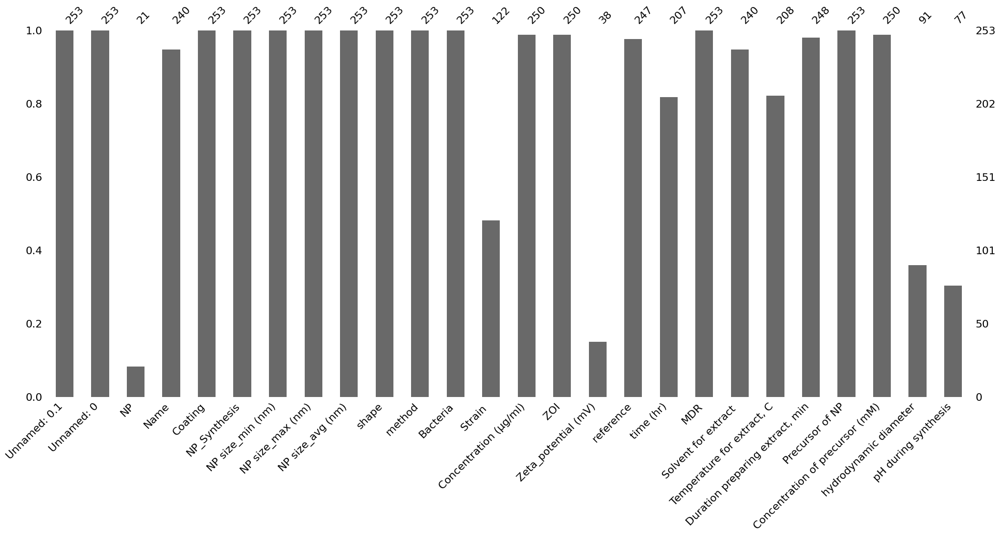

In [ ]:
msno.bar(df)

In [ ]:
lst_ = list()

def find_columns_with_high_nan_ratio(df, existing_list, threshold=0.5):
    existing_list.extend([col for col in df.columns if df[col].isnull().sum() / len(df) >= threshold])
    return existing_list

In [ ]:
lst_ = find_columns_with_high_nan_ratio(df, lst_)
lst_

['NP',
 'Strain ',
 'Zeta_potential (mV)',
 'hydrodynamic diameter',
 'pH during synthesis']

In [ ]:
df['Strain '].isnull().sum(), df.shape[0]

(131, 253)

# **Dropped NP,  Zeta_potential (mV),hydrodynamic diameter,pH during synthesis and Name columns**

In [ ]:
df = df.drop(columns = ['NP', 'Zeta_potential (mV)', 'hydrodynamic diameter','pH during synthesis', 'Name', 'Unnamed: 0'] )

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 253 entries, 0 to 252
Data columns (total 20 columns):
 #   Column                           Non-Null Count  Dtype  
---  ------                           --------------  -----  
 0   Unnamed: 0.1                     253 non-null    int64  
 1   Coating                          253 non-null    float64
 2   NP_Synthesis                     253 non-null    object 
 3   NP size_min (nm)                 253 non-null    float64
 4   NP size_max (nm)                 253 non-null    float64
 5   NP size_avg (nm)                 253 non-null    float64
 6   shape                            253 non-null    object 
 7   method                           253 non-null    object 
 8   Bacteria                         253 non-null    object 
 9   Strain                           122 non-null    object 
 10  Concentration (μg/ml)            250 non-null    float64
 11  ZOI                              250 non-null    float64
 12  reference             

In [ ]:
df.head()

,Unnamed: 0.1,Coating,NP_Synthesis,NP size_min (nm),NP size_max (nm),NP size_avg (nm),shape,method,Bacteria,Strain,Concentration (μg/ml),ZOI,reference,time (hr),MDR,Solvent for extract,"Temperature for extract, C","Duration preparing extract, min",Precursor of NP,Concentration of precursor (mM)
0,0,0.0,green synthesis using fig,4.0,36.0,20.0,spherical,ZOI,Staphylococcus aureus,ATCC 29213,30.0,24.67,https://www.sciencedirect.com/science/article/...,18.0,1.0,water,100.0,15.0,AgNO3,5.0
1,1,0.0,green synthesis using fig,4.0,36.0,20.0,spherical,ZOI,Pseudomonas aeruginosa,ATCC 27853,30.0,NaN,https://www.sciencedirect.com/science/article/...,18.0,0.0,water,100.0,15.0,AgNO3,5.0
2,2,0.0,green synthesis using fig,4.0,36.0,20.0,spherical,ZOI,Streptococcus pyogenes,ATCC 12384,30.0,8.00,https://www.sciencedirect.com/science/article/...,18.0,0.0,water,100.0,15.0,AgNO3,5.0
3,3,0.0,green synthesis using fig,4.0,36.0,20.0,spherical,ZOI,Escherichia coli,ATCC 25922,30.0,14.67,https://www.sciencedirect.com/science/article/...,18.0,0.0,water,100.0,15.0,AgNO3,5.0
4,4,0.0,green synthesis using myrrh,6.0,30.0,18.0,spherical,ZOI,Staphylococcus aureus,ATCC 29213,30.0,23.00,https://www.sciencedirect.com/science/article/...,18.0,1.0,water,100.0,15.0,AgNO3,5.0


# **Filling missing values**

In [ ]:
df['Strain '] = df['Strain '].fillna('N/A')

In [ ]:
df['Strain '].unique()

array(['ATCC 29213', 'ATCC 27853', 'ATCC 12384', 'ATCC 25922', 'MTCC1425',
       'MTCC443', 'MTCC1982', 'ATCC 8739', 'N/A', 'ATCC 700603',
       'PCM 2021', 'ATCC 6338', 'ATCC 10145', 'MRSA', 'VRE', 'ATCC 43300',
       'ATCC 43301', 'ATCC 43302', 'ATCC 43303', 'ATCC 43304',
       'ATCC 43305', 'ATCC 43306', 'ATCC 35218', 'ATCC 29212',
       'ATCC 11778', 'MSSA1', 'MSSA2', 'ECESβL1', 'ECESβL2', 'ECESβL3',
       'ECS', 'ATCC 25923', 'MDRAB', '1617', 'N90PS', '8465', 'PAO1',
       'ATCC 190918', '10P50', 'ATCC 19606', 'PAO2', 'ATCC 190919',
       '10P51', 'ATCC 32240', 'ATCC 38557', 'PAO3', 'ATCC 190920',
       '10P52', 'ATCC 44874', 'ATCC 51191', '700802', 'ATCC 49818',
       'ATCC 4330', 'ATCC 11229', 'ATCC 11230', 'ATCC 11231',
       'ATCC 11232', 'ATCC 11233', 'ATCC 11234', 'ATCC 11235',
       'ATCC 11236', 'ATCC 11237', 'ATCC 11238', 'ATCC 11239'],
      dtype=object)

In [ ]:
df['MDR'] = df['MDR'].fillna(0)

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 253 entries, 0 to 252
Data columns (total 20 columns):
 #   Column                           Non-Null Count  Dtype  
---  ------                           --------------  -----  
 0   Unnamed: 0.1                     253 non-null    int64  
 1   Coating                          253 non-null    float64
 2   NP_Synthesis                     253 non-null    object 
 3   NP size_min (nm)                 253 non-null    float64
 4   NP size_max (nm)                 253 non-null    float64
 5   NP size_avg (nm)                 253 non-null    float64
 6   shape                            253 non-null    object 
 7   method                           253 non-null    object 
 8   Bacteria                         253 non-null    object 
 9   Strain                           253 non-null    object 
 10  Concentration (μg/ml)            250 non-null    float64
 11  ZOI                              250 non-null    float64
 12  reference             

In [ ]:
time_mode = df['time (hr)'].mode()[0]
solvent_mode = df['Solvent for extract '].mode()[0]
mean_of_duration = df['Duration preparing extract, min'].mean()
mode_of_concentration = df['Concentration of precursor (mM)'].mode()[0]
average_temp = df['Temperature for extract, C'].mean()

df['time (hr)'].fillna(time_mode, inplace = True)
df['Solvent for extract '].fillna(solvent_mode, inplace = True)
df['Duration preparing extract, min'].fillna(mean_of_duration, inplace = True)
df['Concentration of precursor (mM)'].fillna(mode_of_concentration, inplace = True)
df['Temperature for extract, C'].fillna(average_temp, inplace = True)

In [ ]:
df_clear = df.dropna()

In [ ]:
df.shape, df_clear.shape

((253, 20), (241, 20))

# **Deleting outliers from dataset using z-score**

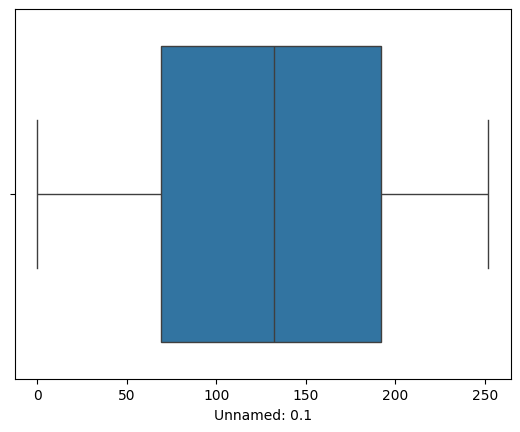

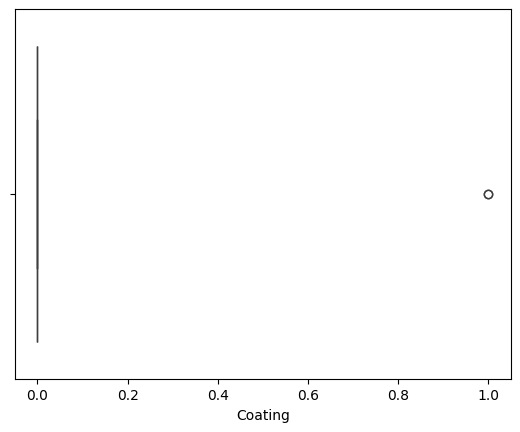

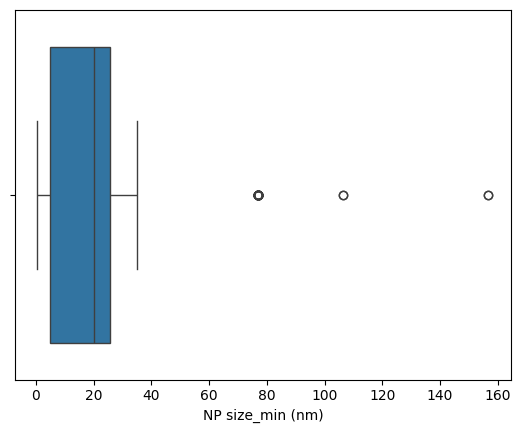

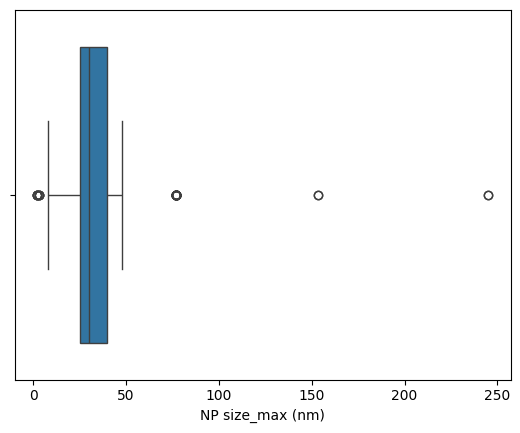

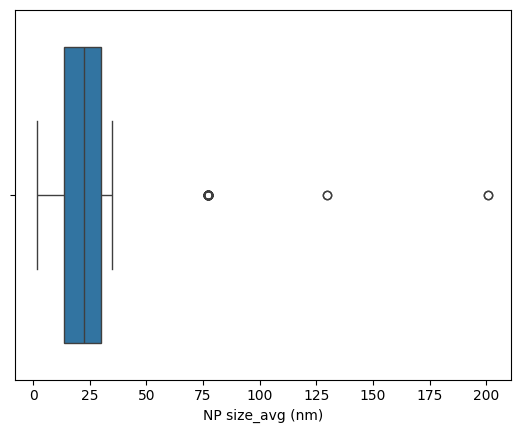

...

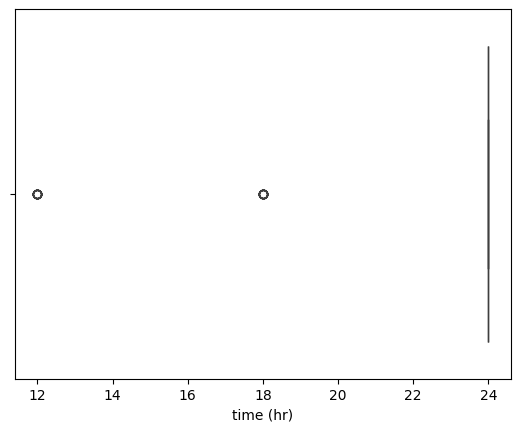

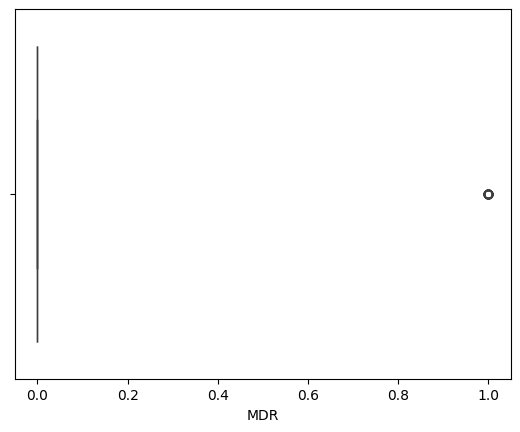

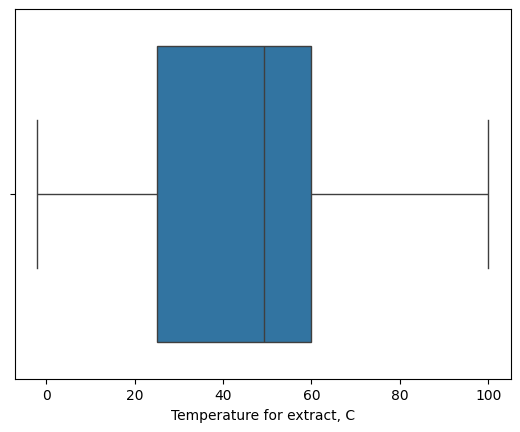

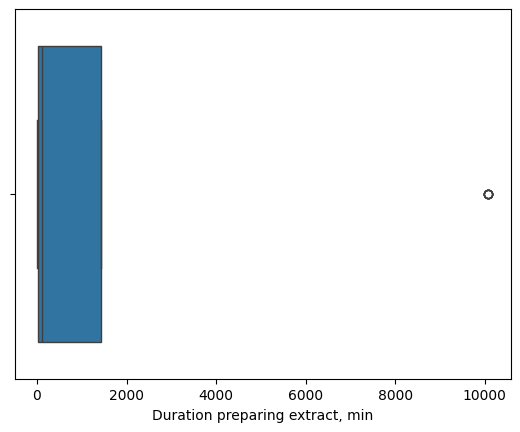

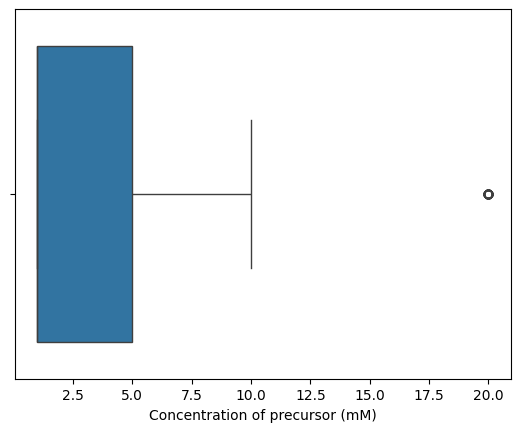

In [ ]:
numeric_columns = list()

for column in df_clear.columns:
  if df_clear[column].dtype in ['float64', 'int64']:
    numeric_columns.append(column)
    plt.figure()
    sns.boxplot(x = df_clear[column])
    plt.show()

In [ ]:
df_clear = df_clear[df_clear['NP size_avg (nm)'] <= 100]

In [ ]:
df_clear = df_clear[df_clear['NP size_min (nm)'] <= 100]
df_clear = df_clear[df_clear['NP size_max (nm)'] <= 100]

In [ ]:
df_clear = df_clear[df_clear['ZOI'] <=40]

In [ ]:
df_clear = df_clear[df_clear['Duration preparing extract, min'] < 10000]

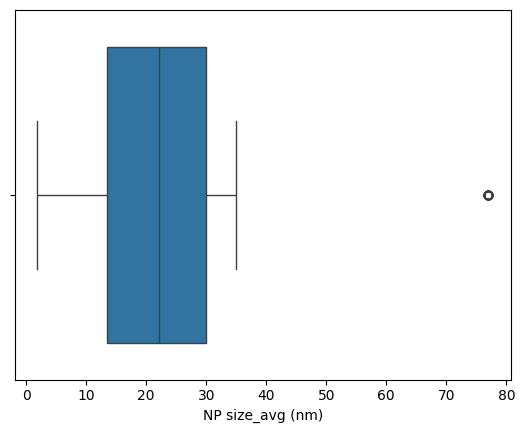

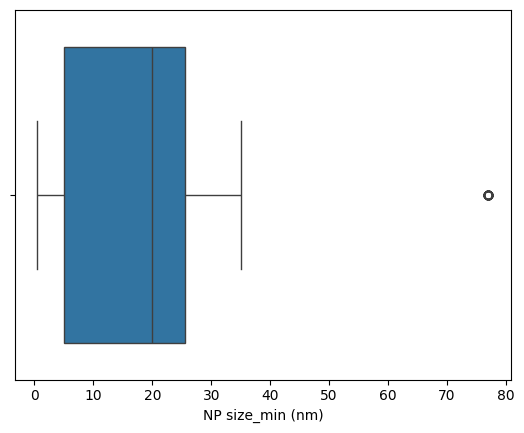

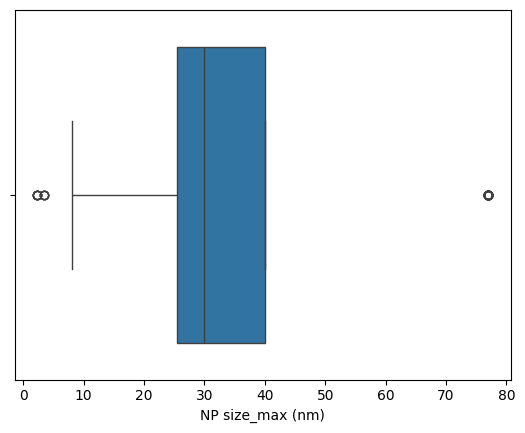

In [ ]:
numeric_columns = list()

for column in ['NP size_avg (nm)', 'NP size_min (nm)', 'NP size_max (nm)']:
  if df_clear[column].dtype in ['float64', 'int64']:
    numeric_columns.append(column)
    plt.figure()
    sns.boxplot(x = df_clear[column])
    plt.show()

In [ ]:
df_clear[df_clear['Concentration of precursor (mM)'] >= 20].shape

(49, 20)

In [ ]:
df_clear.shape

(228, 20)

# **Merge two datasets**

In [ ]:
df_prev = pd.read_csv('/content/drive/MyDrive/Article/Previous datasets/preprocessed_ZOI_NP.csv')

In [ ]:
df_prev.columns

Index(['Unnamed: 0', 'NP', 'NP_Synthesis', 'shape', 'method', 'Bacteria',
       'time (hr)', 'Phylum', 'Class', 'Order', 'Family', 'Superkingdom',
       'bac_type', 'gram', 'isolated_from', 'NP_concentration (μg/ml)',
       'NP size_min (nm)', 'NP size_max (nm)', 'Valance_electron', 'amw',
       'lipinskiHBA', 'NumHBA', 'chi0v', 'kappa1', 'min_Incub_period, h',
       'growth_temp, C', 'biosafety_level', 'reference', 'ZOI_NP (mm)'],
      dtype='object')

In [ ]:
df_prev.isnull().sum()

,0
Unnamed: 0,0
NP,0
NP_Synthesis,0
shape,0
method,0
Bacteria,0
time (hr),0
Phylum,0
Class,0
Order,0


In [ ]:
df_prev['NP_Synthesis'].unique()

array(['green_synthesis from fungus  Aspergillus flavus',
       'green_synthesis from fungus  Phytophthora infestans',
       'green_synthesis using Dioscorea bulbifera tuber extract ',
       'green_synthesis using extract of Klebsiella pneumoniae',
       'green_synthesis using extract of corn leaves',
       'green_synthesis using C. zylinicum aqueous extracts',
       'green_synthesis  by Bacillus sp.', 'purchased from sigma aldrich',
       'green_synthesis using aqueous Cassiarox burghii leaf extract',
       'green_synthesis using the methanolic extracts of marine algae (V. pachynema)',
       'green_synthesis using the methanolic extracts of marine algae (S. wightii)',
       'chemical_synthesis using sodium borohydride and silver ions',
       'chemical_synthesis using sodium borohydride and copper ions',
       'green_synthesis using Ulva fasciata ',
       'green_synthesis using Acinetobacter calcoaceticus',
       'green_synthesis from  Eurotium cristatum',
       'chem_sy

In [ ]:
df_clear.columns

Index(['Unnamed: 0.1', 'Coating', 'NP_Synthesis', 'NP size_min (nm)',
       'NP size_max (nm)', 'NP size_avg (nm)', 'shape', 'method', 'Bacteria',
       'Strain ', 'Concentration (μg/ml)', 'ZOI', 'reference', 'time (hr)',
       'MDR', 'Solvent for extract ', 'Temperature for extract, C',
       'Duration preparing extract, min', 'Precursor of NP',
       'Concentration of precursor (mM)'],
      dtype='object')

In [ ]:
df_clear.to_csv('preprocessed_data_ZOI_for_article.csv')

In [ ]:
df_clear.shape[0]

228

In [ ]:
df_descr = pd.read_csv('/content/drive/MyDrive/Article/descriptors/res_merged_synergy_descriptor.csv')
df_descr.shape[0]

72

In [ ]:
def up_first_letter(x):
  x = x[0].upper() + x[1:]
  return x.rstrip()

In [ ]:
df_descr['Bacteria'] = df_descr['Bacteria'].apply(up_first_letter)

In [ ]:
# df_descr.to_csv('extended_synergy_descriptor_taxonomy.csv')

In [ ]:
df_clear = df_clear.replace(['Pseudomonas aeruginosa ATCC', 'Staphylococcus aureus ', 'Klebsiella pneumonia',
                             'Escherichia coli '],
                        ['Pseudomonas aeruginosa', 'Staphylococcus aureus', 'Klebsiella pneumoniae',
                         'Escherichia coli'])
df_clear = df_clear.query("Bacteria not in ['Streptococcus spp', 'Enterococc','Carbapenem-resistant Enterobacteriaceae', 'Enterococcus sp']")

In [ ]:
df_prev = pd.merge(df_prev, df_descr[['Bacteria', 'Genus', 'Species']], on = 'Bacteria', how='left')

In [ ]:
df_with_descr_new = pd.merge(df_clear, df_descr, on = 'Bacteria', how = 'left')

In [ ]:
df_with_descr_new.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 226 entries, 0 to 225
Data columns (total 40 columns):
 #   Column                           Non-Null Count  Dtype  
---  ------                           --------------  -----  
 0   Unnamed: 0.1_x                   226 non-null    int64  
 1   Coating                          226 non-null    float64
 2   NP_Synthesis                     226 non-null    object 
 3   NP size_min (nm)                 226 non-null    float64
 4   NP size_max (nm)                 226 non-null    float64
 5   NP size_avg (nm)                 226 non-null    float64
 6   shape                            226 non-null    object 
 7   method                           226 non-null    object 
 8   Bacteria                         226 non-null    object 
 9   Strain                           226 non-null    object 
 10  Concentration (μg/ml)            226 non-null    float64
 11  ZOI                              226 non-null    float64
 12  reference             

In [ ]:
df_with_descr_new.shape[0], df_with_descr_new.isnull().sum()

(226,
 Unnamed: 0.1_x                       0
 Coating                              0
 NP_Synthesis                         0
 NP size_min (nm)                     0
 NP size_max (nm)                     0
 NP size_avg (nm)                     0
 shape                                0
 method                               0
 Bacteria                             0
 Strain                               0
 Concentration (μg/ml)                0
 ZOI                                  0
 reference                            0
 time (hr)                            0
 MDR                                  0
 Solvent for extract                  0
 Temperature for extract, C           0
 Duration preparing extract, min      0
 Precursor of NP                      0
 Concentration of precursor (mM)      0
 Unnamed: 0.1_y                       0
 Unnamed: 0                          30
 IdList                               0
 Kingdom                            221
 Clade                            

In [ ]:
df_with_descr_new

,Unnamed: 0.1_x,Coating,NP_Synthesis,NP size_min (nm),NP size_max (nm),NP size_avg (nm),shape,method,Bacteria,Strain,...,Superkingdom,Species,bac_type,gram,"min_Incub_period, h","avg_Incub_period, h","max_Incub_period, h","growth_temp, C",biosafety_level,isolated_from
0,0,0.0,green synthesis using fig,4.0,36.0,20.0,spherical,ZOI,Staphylococcus aureus,ATCC 29213,...,Bacteria,Staphylococcus aureus,pathogenic,p,24.0,36.0,48.0,37.0,2.0,skin
1,2,0.0,green synthesis using fig,4.0,36.0,20.0,spherical,ZOI,Streptococcus pyogenes,ATCC 12384,...,Bacteria,Streptococcus pyogenes,pathogenic,p,24.0,36.0,48.0,37.0,2.0,mouth
2,3,0.0,green synthesis using fig,4.0,36.0,20.0,spherical,ZOI,Escherichia coli,ATCC 25922,...,Bacteria,Escherichia coli,pathogenic,n,48.0,84.0,120.0,37.0,2.0,urine
3,4,0.0,green synthesis using myrrh,6.0,30.0,18.0,spherical,ZOI,Staphylococcus aureus,ATCC 29213,...,Bacteria,Staphylococcus aureus,pathogenic,p,24.0,36.0,48.0,37.0,2.0,skin
4,5,0.0,green synthesis using myrrh,6.0,30.0,18.0,spherical,ZOI,Pseudomonas aeruginosa,ATCC 27853,...,Bacteria,Pseudomonas aeruginosa,opportunistic pathogen,n,24.0,48.0,72.0,37.0,2.0,soil
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
221,248,0.0,green synthesis using flos sophorae,25.0,40.0,32.5,spherical,ZOI,Staphylococcus aureus,N/A,...,Bacteria,Staphylococcus aureus,pathogenic,p,24.0,36.0,48.0,37.0,2.0,skin
222,249,0.0,green synthesis using flos sophorae,25.0,40.0,32.5,spherical,ZOI,Pseudomonas aeruginosa,N/A,...,Bacteria,Pseudomonas aeruginosa,opportunistic pathogen,n,24.0,48.0,72.0,37.0,2.0,soil
223,250,0.0,green synthesis using flos sophorae,25.0,40.0,32.5,spherical,ZOI,Escherichia coli,N/A,...,Bacteria,Escherichia coli,pathogenic,n,48.0,84.0,120.0,37.0,2.0,urine
224,251,0.0,green synthesis using flos sophorae,25.0,40.0,32.5,spherical,ZOI,Staphylococcus aureus,N/A,...,Bacteria,Staphylococcus aureus,pathogenic,p,24.0,36.0,48.0,37.0,2.0,skin


In [ ]:
df_with_descr_new['Bacteria'].unique()

array(['Staphylococcus aureus', 'Streptococcus pyogenes',
       'Escherichia coli', 'Pseudomonas aeruginosa',
       'Enterococcus faecium', 'Staphylococcus haemolyticus',
       'Citrobacter braakii', 'Stenotrophomonas maltophilia',
       'Klebsiella pneumoniae', 'Enterococcus faecalis',
       'Enterobacter cloacae', 'Citrobacter freundii', 'Salmonella typhi',
       'Acidovorax avenae subsp. avenae', 'Acinetobacter baumannii',
       'Staphylococcus epidermidis', 'Streptococcus gordonii',
       'Salmonella gallinarum', 'Enterobacter aerogenes',
       'Micrococcus lotus', 'Bacillus brevis'], dtype=object)

In [ ]:
df_prev.columns, len(df_prev.columns)

(Index(['Unnamed: 0', 'NP', 'NP_Synthesis', 'shape', 'method', 'Bacteria',
        'time (hr)', 'Phylum', 'Class', 'Order', 'Family', 'Superkingdom',
        'bac_type', 'gram', 'isolated_from', 'NP_concentration (μg/ml)',
        'NP size_min (nm)', 'NP size_max (nm)', 'Valance_electron', 'amw',
        'lipinskiHBA', 'NumHBA', 'chi0v', 'kappa1', 'min_Incub_period, h',
        'growth_temp, C', 'biosafety_level', 'reference', 'ZOI_NP (mm)',
        'Genus', 'Species'],
       dtype='object'),
 31)

In [ ]:
def diff_columns(df_old, df_new):
  columns_df_old = set(df_old.columns)
  columns_df_new = set(df_new.columns)
  unique_to_df_old = columns_df_old - columns_df_new
  unique_to_df_new = columns_df_new - columns_df_old
  return {'unique_to_df_old' : unique_to_df_old, 'unique_to_df_new' : unique_to_df_new}

In [ ]:
df_new = df_with_descr_new.drop(columns = ['Unnamed: 0', 'Unnamed: 0.1_x', 'Unnamed: 0.1_y',
                                           'IdList', 'Clade','Kingdom',
                                           'Concentration of precursor (mM)',
                                           'Duration preparing extract, min','MDR',
                                           'NP size_avg (nm)', 'avg_Incub_period, h',
                                           'max_Incub_period, h', 'Coating', 'Precursor of NP',
                                           'Solvent for extract ','Strain ',
                                           'Temperature for extract, C'])
df_old = df_prev.drop(columns = ['Unnamed: 0', 'NP', 'Valance_electron', 'amw',
                                 'lipinskiHBA', 'NumHBA',
                                 'chi0v', 'kappa1'])
df_old = df_old.rename(columns = {'ZOI_NP (mm)':'ZOI'})
df_new = df_new.rename(columns = {'Concentration (μg/ml)':'NP_concentration (μg/ml)'})

In [ ]:
df_new.shape[0], df_old.shape[0]

(226, 1100)

In [ ]:
df_old.isnull().sum()

,0
NP_Synthesis,0
shape,0
method,0
Bacteria,0
time (hr),0
Phylum,0
Class,0
Order,0
Family,0
Superkingdom,0


In [ ]:
df_new.isnull().sum()

,0
NP_Synthesis,0
NP size_min (nm),0
NP size_max (nm),0
shape,0
method,0
Bacteria,0
NP_concentration (μg/ml),0
ZOI,0
reference,0
time (hr),0


In [ ]:
diff = diff_columns(df_old, df_new)

In [ ]:
diff['unique_to_df_old']

set()

In [ ]:
diff['unique_to_df_new']

set()

In [ ]:
df_old.shape[0], df_new.shape[0]

(1100, 226)

In [ ]:
res_df = pd.concat([df_old, df_new])

In [ ]:
def split_row(x):
  if ' and ' in x:
    return x.split(' and ')
  elif ' nano ':
    return x.split(' nano ')

In [ ]:
expl = res_df.explode('shape')
expl['shape'] = expl['shape'].apply(lambda x: split_row(x))

res_df = expl.explode('shape').reset_index(drop=True)

In [ ]:
purch = [i for i in res_df['NP_Synthesis'].unique() if i.startswith('purchased')]
purch_dict = {p: 'chemical_synthesis ' + p for p in purch }

purch_dict

{'purchased from sigma aldrich': 'chemical_synthesis purchased from sigma aldrich',
 'purchased from nanoshel': 'chemical_synthesis purchased from nanoshel',
 'purchased from MK impex corp': 'chemical_synthesis purchased from MK impex corp'}

In [ ]:
res_df['NP_Synthesis'] = res_df['NP_Synthesis'].replace(purch_dict)

In [ ]:
# purch = [i for i in res_df['NP_Synthesis'].unique() if 'purchased' in i]
# purch

In [ ]:
res_df['NP_Synthesis'] = res_df['NP_Synthesis'].replace(['green_synthesis using\xa0Laurus nobilis\xa0(bay leaf):\xa0',
                                                         'green_synthesis using Ulva fasciata ',
                                                         'green_synthesis using Aloe vera leaves',
                                                         'green_synthesis using aloe vera extract',
                                                         'green synthesis using myrrh'],
                                                        ['green_synthesis using Laurus nobilis',
                                                         'green_synthesis using Ulva fasciata',
                                                         'green_synthesis using Aloe vera leaf',
                                                         'green_synthesis using Aloe vera leaf',
                                                         'green green synthesis using commiphora myrrh'])

In [ ]:
e = [i for i in res_df['NP_Synthesis'].unique() if 'chemical' == i]

e

['chemical']

In [ ]:
# res_df['NP_Synthesis'].unique()

In [ ]:
res_df.shape[0]

1454

In [ ]:
res_df = res_df[((res_df['NP_Synthesis'] != 'chemical') & (res_df['NP_Synthesis'] != 'chemical_synthesis'))]


In [ ]:
res_df.shape[0]

1437

In [ ]:
res_df['method'] = res_df['method'].replace(['disk_diffusion'], ['disc_diffusion'])

res_df['method'].unique()

<ipython-input-93-45922b338fb2>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  res_df['method'] = res_df['method'].replace(['disk_diffusion'], ['disc_diffusion'])


array(['disc_diffusion', 'well_diffusion', 'ZOI'], dtype=object)

In [ ]:
res_df.dtypes.unique()

array([dtype('O'), dtype('float64')], dtype=object)

In [ ]:
# cat_col = res_df.select_dtypes(include = 'object').columns
# cat_col

In [ ]:
def find_potential_redundancies(column_name):
    unique_values = res_df[column_name].drop_duplicates().tolist()

    unique_values_cleaned = [val.lower().strip() for val in unique_values]

    potential_redundancies = []

    for i, val1 in enumerate(unique_values_cleaned):
        for j, val2 in enumerate(unique_values_cleaned):
            if i >= j:
                continue
            if val1 in val2 or val2 in val1:
                potential_redundancies.append({
                    'Original_1': unique_values[i],
                    'Original_2': unique_values[j],
                    'Cleaned_1': val1,
                    'Cleaned_2': val2
                })

    return potential_redundancies

r_p_r = find_potential_redundancies('NP_Synthesis')

In [ ]:
r_p_r

[{'Original_1': 'green_synthesis from fungus  Aspergillus flavus',
  'Original_2': 'green_synthesis from fungus',
  'Cleaned_1': 'green_synthesis from fungus  aspergillus flavus',
  'Cleaned_2': 'green_synthesis from fungus'},
 {'Original_1': 'green_synthesis from fungus  Phytophthora infestans',
  'Original_2': 'green_synthesis from fungus',
  'Cleaned_1': 'green_synthesis from fungus  phytophthora infestans',
  'Cleaned_2': 'green_synthesis from fungus'},
 {'Original_1': 'chemical_synthesis using sodium borohydride and silver ions',
  'Original_2': 'chemical_synthesis using sodium borohydride',
  'Cleaned_1': 'chemical_synthesis using sodium borohydride and silver ions',
  'Cleaned_2': 'chemical_synthesis using sodium borohydride'},
 {'Original_1': 'chemical_synthesis using sodium borohydride and copper ions',
  'Original_2': 'chemical_synthesis using sodium borohydride',
  'Cleaned_1': 'chemical_synthesis using sodium borohydride and copper ions',
  'Cleaned_2': 'chemical_synthesis 

In [ ]:
res_df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 1437 entries, 0 to 1453
Data columns (total 23 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   NP_Synthesis              1437 non-null   object 
 1   shape                     1437 non-null   object 
 2   method                    1437 non-null   object 
 3   Bacteria                  1437 non-null   object 
 4   time (hr)                 1437 non-null   float64
 5   Phylum                    1437 non-null   object 
 6   Class                     1437 non-null   object 
 7   Order                     1437 non-null   object 
 8   Family                    1437 non-null   object 
 9   Superkingdom              1437 non-null   object 
 10  bac_type                  1437 non-null   object 
 11  gram                      1437 non-null   object 
 12  isolated_from             1437 non-null   object 
 13  NP_concentration (μg/ml)  1437 non-null   float64
 14  NP size_min (

# **Working with scaling and cat features**

In [ ]:
df_num = res_df.select_dtypes(include = 'number')
df_cat = res_df.select_dtypes(include = 'object').drop(columns = ['reference'])

df_cat_boost = res_df.select_dtypes(include = 'object').drop(columns = ['reference'])

In [ ]:
ref_col = res_df['reference']

In [ ]:
df_num.head()

,time (hr),NP_concentration (μg/ml),NP size_min (nm),NP size_max (nm),"min_Incub_period, h","growth_temp, C",biosafety_level,ZOI
0,24.0,100.0,5.0,30.0,48.0,37.0,2.0,15.0
1,24.0,100.0,5.0,30.0,24.0,37.0,2.0,16.0
2,24.0,100.0,5.0,30.0,240.0,30.0,1.0,14.0
3,24.0,100.0,5.0,30.0,24.0,37.0,2.0,14.0
4,24.0,100.0,5.0,30.0,24.0,37.0,2.0,15.0


<Axes: >

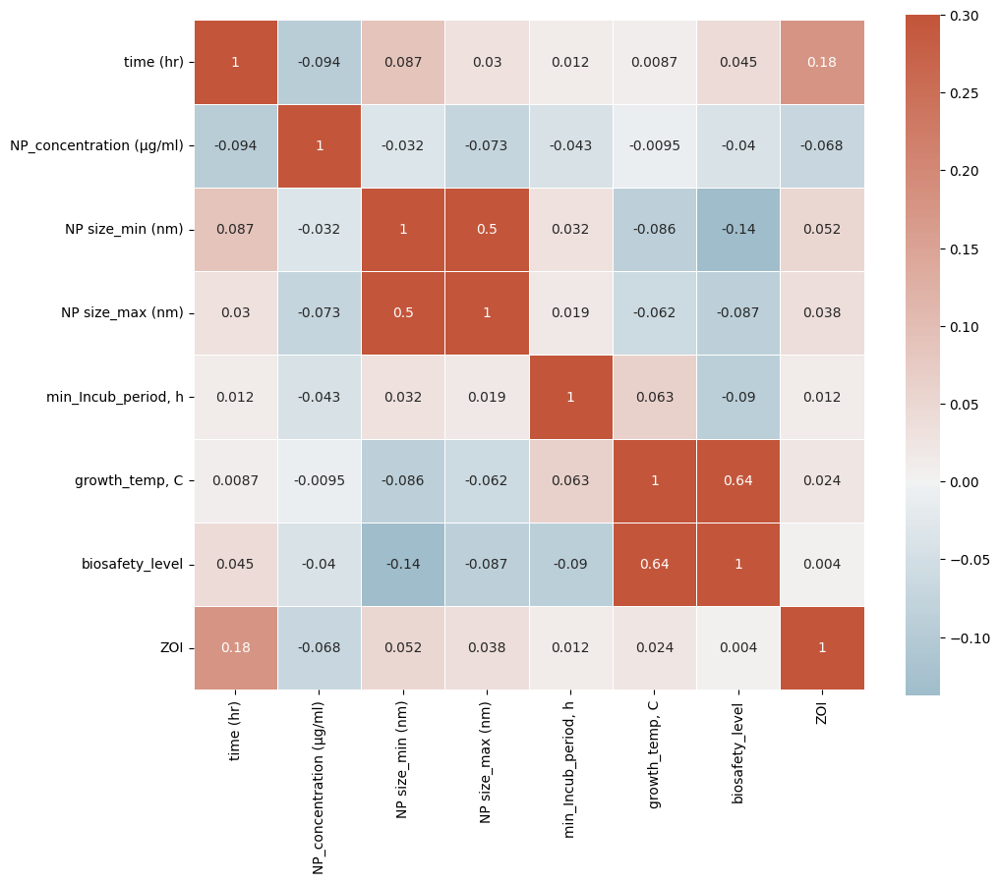

In [ ]:
corr = df_num.corr()
f, ax = plt.subplots(figsize = (11, 9))
cmap = sns.diverging_palette(230,20, as_cmap=True)
sns.heatmap(corr, cmap=cmap, vmax=.3, center=0,square=True, linewidths=.5, annot=True)

In [ ]:
df_cat.shape[0]

1437

In [ ]:
df_cat.head()

,NP_Synthesis,shape,method,Bacteria,Phylum,Class,Order,Family,Superkingdom,bac_type,gram,isolated_from,Genus,Species
0,green_synthesis from fungus Aspergillus flavus,spherical,disc_diffusion,Escherichia coli,Pseudomonadota,Gammaproteobacteria,Enterobacterales,Enterobacteriaceae,Bacteria,pathogenic,n,urine,Escherichia,Escherichia coli
1,green_synthesis from fungus Aspergillus flavus,spherical,disc_diffusion,Staphylococcus aureus,Bacillota,Bacilli,Bacillales,Staphylococcaceae,Bacteria,pathogenic,p,skin,Staphylococcus,Staphylococcus aureus
2,green_synthesis from fungus Aspergillus flavus,spherical,disc_diffusion,Micrococcus luteus,Actinomycetota,Actinomycetes,Micrococcales,Micrococcaceae,Bacteria,opportunistic pathogen,p,soil,Micrococcus,Micrococcus luteus
3,green_synthesis from fungus Aspergillus flavus,spherical,disc_diffusion,Pseudomonas aeruginosa,Pseudomonadota,Gammaproteobacteria,Pseudomonadales,Pseudomonadaceae,Bacteria,opportunistic pathogen,n,soil,Pseudomonas,Pseudomonas aeruginosa
4,green_synthesis from fungus Aspergillus flavus,spherical,disc_diffusion,Enterococcus faecalis,Bacillota,Bacilli,Lactobacillales,Enterococcaceae,Bacteria,pathogenic,p,urine,Enterococcus,Enterococcus faecalis


In [ ]:
len(df_num.columns) + len(df_cat.columns) == len(res_df.columns)

False

In [ ]:
y = df_num['ZOI']
y_ = df_num['ZOI']
df_num = df_num.drop(columns = ['ZOI'])

In [ ]:
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()

for column in df_num.columns:
  df_num[column] = scaler.fit_transform(df_num[[column]])

In [ ]:
# from sklearn.preprocessing import MinMaxScaler

# scaler = MinMaxScaler()

# for column in df_num.columns:
#   df_num[column] = scaler.fit_transform(df_num[[column]])

In [ ]:
df_num.head()

,time (hr),NP_concentration (μg/ml),NP size_min (nm),NP size_max (nm),"min_Incub_period, h","growth_temp, C",biosafety_level
0,0.043485,-0.241863,-0.724716,-0.215608,0.327587,0.668060,0.423525
1,0.043485,-0.241863,-0.724716,-0.215608,-0.239769,0.668060,0.423525
2,0.043485,-0.241863,-0.724716,-0.215608,4.866435,-1.318936,-2.144430
3,0.043485,-0.241863,-0.724716,-0.215608,-0.239769,0.668060,0.423525
4,0.043485,-0.241863,-0.724716,-0.215608,-0.239769,0.668060,0.423525


**Using other encoders in categorical data**

In [ ]:
df_cat.columns

Index(['NP_Synthesis', 'shape', 'method', 'Bacteria', 'Phylum', 'Class',
       'Order', 'Family', 'Superkingdom', 'bac_type', 'gram', 'isolated_from',
       'Genus', 'Species'],
      dtype='object')

In [ ]:
df_cat['shape'] = df_cat['shape'].replace(['Spherical', 'semi-spherical', 'quasi-hexagonal', 'quasi-spherical', 'pseudo-spherical', 'spherical nano clusters', 'triangles','polygonal '],
                                          ['spherical', 'spherical_semi', 'hexagonal_quasi', 'spherical_quasi', 'spherical_pseudo', 'spherical', 'triangular', 'polygonal'])

In [ ]:
df_cat['shape'].unique(), len(df_cat['shape'].unique())

(array(['spherical', 'nanorods', 'triangular', 'spherical_semi',
        'globular', 'cubic', 'clusters', 'tubular', 'hexagonal',
        'polygonal', 'cube', 'nanoplates', 'snowflake', 'ellipsoidal',
        'spheroidal', 'hexagonal_quasi', 'cylindrical', 'rod-shaped',
        'spherical_quasi', 'spherical_pseudo'], dtype=object),
 20)

In [ ]:
df_cat.head()

,NP_Synthesis,shape,method,Bacteria,Phylum,Class,Order,Family,Superkingdom,bac_type,gram,isolated_from,Genus,Species
0,green_synthesis from fungus Aspergillus flavus,spherical,disc_diffusion,Escherichia coli,Pseudomonadota,Gammaproteobacteria,Enterobacterales,Enterobacteriaceae,Bacteria,pathogenic,n,urine,Escherichia,Escherichia coli
1,green_synthesis from fungus Aspergillus flavus,spherical,disc_diffusion,Staphylococcus aureus,Bacillota,Bacilli,Bacillales,Staphylococcaceae,Bacteria,pathogenic,p,skin,Staphylococcus,Staphylococcus aureus
2,green_synthesis from fungus Aspergillus flavus,spherical,disc_diffusion,Micrococcus luteus,Actinomycetota,Actinomycetes,Micrococcales,Micrococcaceae,Bacteria,opportunistic pathogen,p,soil,Micrococcus,Micrococcus luteus
3,green_synthesis from fungus Aspergillus flavus,spherical,disc_diffusion,Pseudomonas aeruginosa,Pseudomonadota,Gammaproteobacteria,Pseudomonadales,Pseudomonadaceae,Bacteria,opportunistic pathogen,n,soil,Pseudomonas,Pseudomonas aeruginosa
4,green_synthesis from fungus Aspergillus flavus,spherical,disc_diffusion,Enterococcus faecalis,Bacillota,Bacilli,Lactobacillales,Enterococcaceae,Bacteria,pathogenic,p,urine,Enterococcus,Enterococcus faecalis


In [ ]:
from sklearn.preprocessing import LabelEncoder

le = LabelEncoder()
for column in df_cat.columns:
  df_cat[column] = le.fit_transform(df_cat[column])

In [ ]:
# df_num = df_num.reset_index()
# df_cat = df_cat.reset_index()

df_for_model_scaled = pd.concat([df_cat, df_num], axis = 1)

df_cat_boost = pd.concat([df_cat_boost, df_num], axis = 1)

In [ ]:
df_for_model_scaled.info()

<class 'pandas.core.frame.DataFrame'>
Index: 1437 entries, 0 to 1453
Data columns (total 21 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   NP_Synthesis              1437 non-null   int64  
 1   shape                     1437 non-null   int64  
 2   method                    1437 non-null   int64  
 3   Bacteria                  1437 non-null   int64  
 4   Phylum                    1437 non-null   int64  
 5   Class                     1437 non-null   int64  
 6   Order                     1437 non-null   int64  
 7   Family                    1437 non-null   int64  
 8   Superkingdom              1437 non-null   int64  
 9   bac_type                  1437 non-null   int64  
 10  gram                      1437 non-null   int64  
 11  isolated_from             1437 non-null   int64  
 12  Genus                     1437 non-null   int64  
 13  Species                   1437 non-null   int64  
 14  time (hr)    

In [ ]:
df_for_model_scaled = pd.concat([df_for_model_scaled, ref_col], axis = 1)

In [ ]:
df_for_model_scaled.info()

<class 'pandas.core.frame.DataFrame'>
Index: 1437 entries, 0 to 1453
Data columns (total 22 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   NP_Synthesis              1437 non-null   int64  
 1   shape                     1437 non-null   int64  
 2   method                    1437 non-null   int64  
 3   Bacteria                  1437 non-null   int64  
 4   Phylum                    1437 non-null   int64  
 5   Class                     1437 non-null   int64  
 6   Order                     1437 non-null   int64  
 7   Family                    1437 non-null   int64  
 8   Superkingdom              1437 non-null   int64  
 9   bac_type                  1437 non-null   int64  
 10  gram                      1437 non-null   int64  
 11  isolated_from             1437 non-null   int64  
 12  Genus                     1437 non-null   int64  
 13  Species                   1437 non-null   int64  
 14  time (hr)    

In [ ]:
df_for_model_scaled.to_csv('merged_old_new_ZOI.csv')

In [ ]:
df_w = df_for_model_scaled.drop(columns=['reference'])

# **Splitting train and val**

In [ ]:
X = df_for_model_scaled.drop(columns = ['reference'])
X_ = X

X_cat = df_cat_boost

In [ ]:
X.info()

<class 'pandas.core.frame.DataFrame'>
Index: 1437 entries, 0 to 1453
Data columns (total 21 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   NP_Synthesis              1437 non-null   int64  
 1   shape                     1437 non-null   int64  
 2   method                    1437 non-null   int64  
 3   Bacteria                  1437 non-null   int64  
 4   Phylum                    1437 non-null   int64  
 5   Class                     1437 non-null   int64  
 6   Order                     1437 non-null   int64  
 7   Family                    1437 non-null   int64  
 8   Superkingdom              1437 non-null   int64  
 9   bac_type                  1437 non-null   int64  
 10  gram                      1437 non-null   int64  
 11  isolated_from             1437 non-null   int64  
 12  Genus                     1437 non-null   int64  
 13  Species                   1437 non-null   int64  
 14  time (hr)    

In [ ]:
X.columns

Index(['NP_Synthesis', 'shape', 'method', 'Bacteria', 'Phylum', 'Class',
       'Order', 'Family', 'Superkingdom', 'bac_type', 'gram', 'isolated_from',
       'Genus', 'Species', 'time (hr)', 'NP_concentration (μg/ml)',
       'NP size_min (nm)', 'NP size_max (nm)', 'min_Incub_period, h',
       'growth_temp, C', 'biosafety_level'],
      dtype='object')

In [ ]:
from sklearn.model_selection import train_test_split

x_train, x_val, y_train, y_val = train_test_split(X, y, random_state = 42)

x_train_cat, x_val_cat, y_train_cat, y_val_cat = train_test_split(X_cat, y, random_state = 42)

In [ ]:
x_train.info()

<class 'pandas.core.frame.DataFrame'>
Index: 1077 entries, 355 to 1143
Data columns (total 21 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   NP_Synthesis              1077 non-null   int64  
 1   shape                     1077 non-null   int64  
 2   method                    1077 non-null   int64  
 3   Bacteria                  1077 non-null   int64  
 4   Phylum                    1077 non-null   int64  
 5   Class                     1077 non-null   int64  
 6   Order                     1077 non-null   int64  
 7   Family                    1077 non-null   int64  
 8   Superkingdom              1077 non-null   int64  
 9   bac_type                  1077 non-null   int64  
 10  gram                      1077 non-null   int64  
 11  isolated_from             1077 non-null   int64  
 12  Genus                     1077 non-null   int64  
 13  Species                   1077 non-null   int64  
 14  time (hr)  

In [ ]:
df_for_model_scaled.head()

,NP_Synthesis,shape,method,Bacteria,Phylum,Class,Order,Family,Superkingdom,bac_type,...,Genus,Species,time (hr),NP_concentration (μg/ml),NP size_min (nm),NP size_max (nm),"min_Incub_period, h","growth_temp, C",biosafety_level,reference
0,58,13,1,20,4,5,3,8,0,2,...,11,15,0.043485,-0.241863,-0.724716,-0.215608,0.327587,0.668060,0.423525,https://www.tandfonline.com/doi/full/10.2147/I...
1,58,13,1,48,2,2,1,22,0,2,...,26,41,0.043485,-0.241863,-0.724716,-0.215608,-0.239769,0.668060,0.423525,https://www.tandfonline.com/doi/full/10.2147/I...
2,58,13,1,28,0,0,8,13,0,1,...,15,21,0.043485,-0.241863,-0.724716,-0.215608,4.866435,-1.318936,-2.144430,https://www.tandfonline.com/doi/full/10.2147/I...
3,58,13,1,34,4,5,13,19,0,1,...,20,28,0.043485,-0.241863,-0.724716,-0.215608,-0.239769,0.668060,0.423525,https://www.tandfonline.com/doi/full/10.2147/I...
4,58,13,1,17,2,2,6,9,0,2,...,10,13,0.043485,-0.241863,-0.724716,-0.215608,-0.239769,0.668060,0.423525,https://www.tandfonline.com/doi/full/10.2147/I...


# **Applying models for data preprocessed**

In [ ]:
!pip install lazypredict

**Lazy predict with scaled numeric data**

In [ ]:
from sklearn.metrics import r2_score, accuracy_score, mean_squared_error
from lazypredict.Supervised import LazyRegressor

reg_r2 = LazyRegressor(verbose=0, custom_metric=r2_score)

models_scaled, predictions = reg_r2.fit(x_train, x_val, y_train, y_val)

/usr/local/lib/python3.10/dist-packages/dask/dataframe/__init__.py:42: FutureWarning: 
Dask dataframe query planning is disabled because dask-expr is not installed.

You can install it with `pip install dask[dataframe]` or `conda install dask`.
This will raise in a future version.

  warnings.warn(msg, FutureWarning)
 98%|█████████▊| 41/42 [00:19<00:00,  1.87it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000683 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 530
[LightGBM] [Info] Number of data points in the train set: 1077, number of used features: 21
[LightGBM] [Info] Start training from score 14.448544


100%|██████████| 42/42 [00:19<00:00,  2.12it/s]


In [ ]:
models_scaled

,Adjusted R-Squared,R-Squared,RMSE,Time Taken,r2_score
Model,,,,,
XGBRegressor,0.78,0.79,2.49,1.87,0.79
LGBMRegressor,0.73,0.74,2.78,0.29,0.74
RandomForestRegressor,0.72,0.74,2.81,2.72,0.74
HistGradientBoostingRegressor,0.71,0.73,2.86,0.82,0.73
ExtraTreesRegressor,0.70,0.72,2.92,1.43,0.72
BaggingRegressor,0.67,0.69,3.04,0.26,0.69
DecisionTreeRegressor,0.56,0.59,3.53,0.11,0.59
ExtraTreeRegressor,0.56,0.58,3.54,0.07,0.58
GradientBoostingRegressor,0.56,0.58,3.54,0.49,0.58


In [ ]:
!pip install h2o

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 265.6/265.6 MB 2.5 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for h2o: filename=h2o-3.46.0.5-py2.py3-none-any.whl size=265646558 sha256=570110862e85d01cfc48e3ee9df82bd308fabac1098eb8f3c38f60ded0571ee5
  Stored in directory: /root/.cache/pip/wheels/1a/46/4f/9b366522399306d7849672d58aefb44c9b73378d710bde2853
Successfully built h2o


In [ ]:
import h2o
from h2o.automl import H2OAutoML

h2o.init()
data = pd.concat([X, y], axis = 1)

data.to_csv('data.csv')

data = h2o.import_file('data.csv')

x= data.columns
y = 'ZOI'
x.remove(y)

Checking whether there is an H2O instance running at http://localhost:54321..... not found.
Attempting to start a local H2O server...
  Java Version: openjdk version "11.0.24" 2024-07-16; OpenJDK Runtime Environment (build 11.0.24+8-post-Ubuntu-1ubuntu322.04); OpenJDK 64-Bit Server VM (build 11.0.24+8-post-Ubuntu-1ubuntu322.04, mixed mode, sharing)
  Starting server from /usr/local/lib/python3.10/dist-packages/h2o/backend/bin/h2o.jar
  Ice root: /tmp/tmpduyc8rrm
  JVM stdout: /tmp/tmpduyc8rrm/h2o_unknownUser_started_from_python.out
  JVM stderr: /tmp/tmpduyc8rrm/h2o_unknownUser_started_from_python.err
  Server is running at http://127.0.0.1:54321
Connecting to H2O server at http://127.0.0.1:54321 ... successful.


H2O_cluster_uptime:,07 secs
H2O_cluster_timezone:,Etc/UTC
H2O_data_parsing_timezone:,UTC
H2O_cluster_version:,3.46.0.5
H2O_cluster_version_age:,10 days
H2O_cluster_name:,H2O_from_python_unknownUser_bobeoa
H2O_cluster_total_nodes:,1
H2O_cluster_free_memory:,3.170 Gb
H2O_cluster_total_cores:,2
H2O_cluster_allowed_cores:,2
H2O_cluster_status:,"locked, healthy"


Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%


In [ ]:
train, test = data.split_frame(ratios = [0.8])
aml = H2OAutoML(max_runtime_secs=3600)
aml.train(x=x, y=y, training_frame = train)
leaderboard = aml.leaderboard

AutoML progress: |█████████████████████████ (cancelled)


H2OJobCancelled: Job<$03017f00000132d4ffffffff$_87245902e4470a23ce57b322a05c4c25> was cancelled by the user.

In [ ]:
leaderboard

NameError: name 'leaderboard' is not defined

In [ ]:
leaderboard.tail()

NameError: name 'leaderboard' is not defined

In [ ]:
model_id = leaderboard[0, 'model_id']
model_h2o = h2o.get_model(model_id)

NameError: name 'leaderboard' is not defined

In [ ]:
model_dl_id = leaderboard[leaderboard['model_id'] == 'DeepLearning_grid_2_AutoML_1_20240813_90210_model_1'][0,'model_id']
model_dl_id

In [ ]:
# model_dl = h2o.get_model(model_dl_id)

In [ ]:
# model_dl

In [ ]:
# model_h2o

In [ ]:
!pip install mljar-supervised

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.1/127.1 kB 5.5 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 60.4/60.4 kB 2.4 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Using cached jedi-0.19.1-py2.py3-none-any.whl.metadata (22 kB)
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 98.7/98.7 MB 7.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 81.9/81.9 kB 5.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 91.8/91.8 kB 3.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 362.8/362.8 kB 20.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 36.4/36.4 MB 23.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 540.1/540.1 kB 28.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 233.0/233.0 kB 13.7 MB/s eta 0:00:00
Using cached jedi-0.19.1-py2.py3-none-any.whl (1.6 MB)
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 78.6/78.6 kB 4.9 MB/s eta 0:00:00
  

In [ ]:
!pip show mljar-supervised

In [ ]:
from supervised.automl import AutoML

automl = AutoML(mode = 'Perform', ml_task = 'regression',
                algorithms=['Decision Tree', 'Random Forest', 'Xgboost', 'CatBoost', 'Neural Network'])

In [ ]:
automl.fit(x_train, y_train)

AutoML directory: AutoML_1
The task is regression with evaluation metric rmse
AutoML will use algorithms: ['Decision Tree', 'Random Forest', 'Xgboost', 'CatBoost', 'Neural Network']
AutoML will ensemble available models
AutoML steps: ['simple_algorithms', 'default_algorithms', 'not_so_random', 'golden_features', 'insert_random_feature', 'features_selection', 'hill_climbing_1', 'hill_climbing_2', 'ensemble']
* Step simple_algorithms will try to check up to 3 models
1_DecisionTree rmse 5.142743 trained in 24.91 seconds (1-sample predict time 0.1283 seconds)
2_DecisionTree rmse 4.837722 trained in 16.56 seconds (1-sample predict time 0.11 seconds)
3_DecisionTree rmse 4.843357 trained in 9.09 seconds (1-sample predict time 0.0885 seconds)
* Step default_algorithms will try to check up to 4 models
4_Default_Xgboost rmse 3.525975 trained in 14.57 seconds (1-sample predict time 0.0705 seconds)
5_Default_CatBoost rmse 3.506566 trained in 13.82 seconds (1-sample predict time 0.0657 seconds)
6_D

AutoML(algorithms=['Decision Tree', 'Random Forest', 'Xgboost', 'CatBoost',
                   'Neural Network'],
       ml_task='regression', mode='Perform')

In [ ]:
leaderboard_automl = automl.get_leaderboard()

In [ ]:
leaderboard_automl.columns

Index(['name', 'model_type', 'metric_type', 'metric_value', 'train_time',
       'single_prediction_time'],
      dtype='object')

In [ ]:
leaderboard_automl.sort_values('metric_value')

,name,model_type,metric_type,metric_value,train_time,single_prediction_time
59,Ensemble,Ensemble,rmse,3.35,0.79,0.33
48,41_Xgboost_GoldenFeatures_SelectedFeatures,Xgboost,rmse,3.40,13.29,0.19
46,39_Xgboost_GoldenFeatures,Xgboost,rmse,3.40,18.19,0.11
33,26_Xgboost_GoldenFeatures,Xgboost,rmse,3.42,15.25,0.20
31,24_Xgboost_GoldenFeatures_SelectedFeatures,Xgboost,rmse,3.42,15.18,0.14
27,10_Xgboost_GoldenFeatures_SelectedFeatures,Xgboost,rmse,3.43,15.39,0.20
23,10_Xgboost_GoldenFeatures,Xgboost,rmse,3.44,21.28,0.12
47,40_Xgboost_GoldenFeatures_SelectedFeatures,Xgboost,rmse,3.45,12.11,0.15
45,38_Xgboost_GoldenFeatures,Xgboost,rmse,3.46,14.08,0.13
38,31_CatBoost_SelectedFeatures,CatBoost,rmse,3.48,10.35,0.05


In [ ]:
automl.report()

Best model,name,model_type,metric_type,metric_value,train_time,single_prediction_time
,1_DecisionTree,Decision Tree,rmse,5.14274,30.34,0.1283
,2_DecisionTree,Decision Tree,rmse,4.83772,20.17,0.11
,3_DecisionTree,Decision Tree,rmse,4.84336,11.23,0.0885
,4_Default_Xgboost,Xgboost,rmse,3.52598,15.68,0.0705
,5_Default_CatBoost,CatBoost,rmse,3.50657,14.99,0.0657
,6_Default_NeuralNetwork,Neural Network,rmse,5.33078,7.25,0.169
,7_Default_RandomForest,Random Forest,rmse,4.71713,19.99,0.1968
,8_Xgboost,Xgboost,rmse,3.51151,9.69,0.0881
,12_CatBoost,CatBoost,rmse,3.64233,25.24,0.0611
,16_RandomForest,Random Forest,rmse,4.77314,22.9,0.2244


In [ ]:
!ls

AutoML_1  drive		      merged_old_new_ZOI.csv		     sample_data
data.csv  finished_excel.csv  preprocessed_data_ZOI_for_article.csv


In [ ]:
!cp -r /content/AutoML_1 /content/drive/My\ Drive/Article/Colabs

# **Applying simple models that maded by hand**

In [ ]:
!pip install Xgboost

In [ ]:
import json

def extract_specific_learner_parameters(json_file_path):
    with open(json_file_path, 'r') as file:
        data = json.load(file)

    required_params_xgb = [
        'n_jobs',
        'objective',
        'eta',
        'max_depth',
        'min_child_weight',
        'subsample',
        'colsample_bytree',
        'eval_metric'
    ]

    required_params_dt = [
        'criterion',
        'max_depth'
    ]

    learner_params = data.get('params', {}).get('learner', {})

    if 'Xgboost' in json_file_path:
      filtered_params = {param: learner_params.get(param) for param in required_params_xgb}
    else:
      filtered_params = {param: learner_params.get(param) for param in required_params_dt}

    return filtered_params

In [ ]:
import numpy as np
from sklearn.metrics import r2_score
from sklearn.linear_model import LinearRegression
from sklearn.ensemble import VotingRegressor
from sklearn.tree import DecisionTreeRegressor
import xgboost as xgb

weights = {
    '11_Xgboost': 1,
    '24_Xgboost_SelectedFeatures': 5,
    '2_DecisionTree': 1,
    '36_Xgboost_SelectedFeatures': 7,
    '37_Xgboost_SelectedFeatures': 4,
    '38_Xgboost_SelectedFeatures': 4
}

params = dict()
main_path = '/content/drive/MyDrive/Article/Colabs/AutoML_1/'
json_file_path =  '/framework.json'

for param in weights.keys():
  params[param] = extract_specific_learner_parameters(main_path+param+json_file_path)



In [ ]:
model_11_Xgboost = xgb.XGBRegressor(**params['11_Xgboost'])
model_24_Xgboost = xgb.XGBRegressor(**params['24_Xgboost_SelectedFeatures'])
model_2_DecisionTree = DecisionTreeRegressor(**params['2_DecisionTree'])
model_36_Xgboost = xgb.XGBRegressor(**params['36_Xgboost_SelectedFeatures'])
model_37_Xgboost = xgb.XGBRegressor(**params['37_Xgboost_SelectedFeatures'])
model_38_Xgboost = xgb.XGBRegressor(**params['38_Xgboost_SelectedFeatures'])

models = [
    ('11_Xgboost', model_11_Xgboost),
    ('24_Xgboost_SelectedFeatures', model_24_Xgboost),
    ('2_DecisionTree', model_2_DecisionTree),
    ('36_Xgboost_SelectedFeatures', model_36_Xgboost),
    ('37_Xgboost_SelectedFeatures', model_37_Xgboost),
    ('38_Xgboost_SelectedFeatures', model_38_Xgboost)
]

ensemble_model = VotingRegressor(estimators = models, weights = list(weights.values()))

ensemble_model.fit(x_train, y_train)

In [ ]:
ensemble_predictions = ensemble_model.predict(x_val)

In [ ]:
def scatter_plot(y_test, y_test_preds,y_train = None, y_train_preds=None, title='Catboost Model', xlim = (0, 35), ylim = (0, 35)):
    custom_params = {"axes.spines.right": False, "axes.spines.top": False}
    sns.set_theme(style="ticks", rc=custom_params)

    f, ax = plt.subplots(figsize=(6, 6))
    if y_train != None:
      plt.scatter(y_train, y_train_preds, color='#2d4d85', s=30, label='Train dataset', alpha=0.7)
    plt.scatter(y_test, y_test_preds, color='#951d6d', s=30, label='Test dataset', alpha=0.7)
    plt.plot(y_test, y_test, color='#444444', linewidth=2)

    plt.gca().spines['bottom'].set_color('black')
    plt.gca().spines['bottom'].set_linewidth(3)
    plt.gca().spines['left'].set_color('black')
    plt.gca().spines['left'].set_linewidth(3)

    plt.title(title)
    plt.xlabel('Actual data')
    plt.ylabel('Predicted data')
    plt.legend(loc='upper left')
    plt.xlim(xlim)
    plt.ylim(ylim)

    # plt.savefig(save_path, transparent=True)
    plt.show()



In [ ]:
scatter_plot(y_val, ensemble_predictions, title = 'Ensemble model')

In [ ]:
r2_score(y_val, ensemble_predictions)

In [ ]:
from xgboost import XGBRegressor

xgb = XGBRegressor()

xgb.fit(x_train, y_train)

In [ ]:
xgb_predictions = xgb.predict(x_val)

In [ ]:
scatter_plot(y_val, xgb_predictions, title = 'XGBoost model')

In [ ]:
r2_score(y_val, xgb_predictions)

In [ ]:
!pip install catboost

In [ ]:
from catboost import CatBoostRegressor

cat = CatBoostRegressor()

cat.fit(x_train, y_train)

In [ ]:
cat_predictions = cat.predict(x_val)

In [ ]:
scatter_plot(cat_predictions, y_val)

In [ ]:
r2_score(cat_predictions, y_val)

In [ ]:
cat_feat = CatBoostRegressor(cat_features = x_train.select_dtypes(include = 'object').columns.tolist())

cat_feat.fit(x_train, y_train)

In [ ]:
cat_feat_predictions = cat_feat.predict(x_val)

In [ ]:
r2_score(cat_feat_predictions, y_val)


In [ ]:
scatter_plot(y_val, cat_feat_predictions, title = 'XGBoost model')

# **Using PCA and tSNE for visualization of high dimension data in 2d and 3d plot**

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
from sklearn.preprocessing import LabelEncoder

def plot_clusters(x_data, clusters, method_name, title):
    plt.figure(figsize=(10, 6))
    scatter = plt.scatter(x_data[:, 0], x_data[:, 1], c=clusters, cmap='tab10', alpha=0.7)
    plt.xlabel(f'{method_name} Component 1')
    plt.ylabel(f'{method_name} Component 2')
    plt.title(title)
    legend = plt.legend(*scatter.legend_elements(), title="Clusters")
    plt.gca().add_artist(legend)
    plt.show()

def prepare_and_visualize(df, feature_name):
    clusters = df_w[feature_name]

    pca = PCA(n_components=2)
    x_pca = pca.fit_transform(df_w)

    tsne = TSNE(n_components=2, perplexity=30, n_iter=1000, random_state=42)
    x_tsne = tsne.fit_transform(df_w)

    plot_clusters(x_pca, clusters, 'PCA', f'{feature_name} - PCA Clustering')

    plot_clusters(x_tsne, clusters, 't-SNE', f'{feature_name} - t-SNE Clustering')

features_to_cluster = ['NP_Synthesis', 'shape', 'Superkingdom', 'Genus', 'Species']

for feature in features_to_cluster:
    prepare_and_visualize(df_w, feature)


In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE

def plot_clusters_3d(x_data, clusters, method_name, title):
    fig = plt.figure(figsize=(12, 10))
    ax = fig.add_subplot(111, projection='3d')
    scatter = ax.scatter(x_data[:, 0], x_data[:, 1], x_data[:, 2], c=clusters, cmap='tab10', alpha=0.7)
    ax.set_xlabel(f'{method_name} Component 1')
    ax.set_ylabel(f'{method_name} Component 2')
    ax.set_zlabel(f'{method_name} Component 3')
    ax.set_title(title)
    legend = ax.legend(*scatter.legend_elements(), title="Clusters")
    ax.add_artist(legend)
    plt.show()

def prepare_and_visualize_3d(df_w, feature_name):
    clusters = df_w[feature_name]

    pca = PCA(n_components=3)
    x_pca = pca.fit_transform(df_w)

    tsne = TSNE(n_components=3, perplexity=30, n_iter=1000, random_state=42)
    x_tsne = tsne.fit_transform(df_w)

    plot_clusters_3d(x_pca, clusters, 'PCA', f'{feature_name} - PCA Clustering')

    plot_clusters_3d(x_tsne, clusters, 't-SNE', f'{feature_name} - t-SNE Clustering')

features_to_cluster = ['NP_Synthesis', 'shape', 'Superkingdom', 'Genus', 'Species']

for feature in features_to_cluster:
    prepare_and_visualize_3d(df_w, feature)


# **Searching hyperparametrs for XGBoost and Ensemble models**

In [ ]:
!pip install optuna

In [ ]:
from xgboost import XGBRegressor
from sklearn.metrics import r2_score, mean_squared_error
from sklearn.model_selection import KFold
from sklearn.metrics import mean_squared_error
import optuna

def objective(trial, x, y):
    param = {
        'max_depth': trial.suggest_int('max_depth', 3, 20),
        'learning_rate': trial.suggest_float('learning_rate', 0.01, 0.3),
        'n_estimators': trial.suggest_int('n_estimators', 500, 5200, step = 1),
        'min_child_weight': trial.suggest_int('min_child_weight', 1, 10),
        'gamma': trial.suggest_float('gamma', 0, 0),
        'subsample': trial.suggest_float('subsample',1.0, 1.0),
        'colsample_bytree': trial.suggest_float('colsample_bytree', 0.5, 1.0),
        'reg_alpha': trial.suggest_float('reg_alpha', 0.01, 0.5),
        'reg_lambda': trial.suggest_float('reg_lambda', 0.5, 1.0),
    }
    cv = KFold(n_splits=10, shuffle=True, random_state=42)

    cv_scores = np.empty(10)

    for idx, (train_idx, test_idx) in enumerate(cv.split(x, y)):
        x_train, x_test = x.iloc[train_idx], x.iloc[test_idx]
        y_train, y_test = y.iloc[train_idx], y.iloc[test_idx]
        model = XGBRegressor(**param)
        model.fit(x_train, y_train)
        pred_train = model.predict(x_train)
        pred_test = model.predict(x_test)
        print('training_r2', r2_score(y_train, pred_train))
        print('mean_sq_error', mean_squared_error(y_train, pred_train))
        cv_scores[idx] = r2_score(y_test, pred_test)
        print('r2', idx, cv_scores)

    return np.mean(cv_scores)

study = optuna.create_study(direction="maximize", study_name="XGB_Regressor")
func = lambda trial: objective(trial, x_train, y_train)
study.optimize(func, n_trials=20)

fig_list = [
    optuna.visualization.plot_optimization_history(study),
    optuna.visualization.plot_param_importances(study)
]

print(f"\tBest value (rmse): {study.best_value:.5f}")
print(f"\tBest params:")

for key, value in study.best_params.items():
    print(f"\t\t{key}: {value}")




In [ ]:
for fig in fig_list:
    fig.update_layout(width=1000)
    fig.show()

In [ ]:
# import xgboost as xgb
# import json

# params_xgb = study.best_params

# open('params_xgb.txt', 'w').write(json.dumps(params_xgb))

# xgb_reg_param = xgb.XGBRegressor(**params_xgb)

In [ ]:
import json

with open('params_xgb.txt') as file:
  for l in file:
    params_xgb = l

params_xgb = json.loads(params_xgb)

In [ ]:
print(type(params_xgb))

In [ ]:
print(params_xgb)

In [ ]:
from sklearn.model_selection import cross_val_score

model_em_xgb = xgb.XGBRegressor(**params_xgb)

kf_xgb = KFold(n_splits = 5, shuffle = True, random_state=42)

scores = cross_val_score(model_em_xgb, x_train, y_train, cv = kf_xgb, scoring = 'r2')

model_em_xgb.fit(x_train, y_train)

In [ ]:
print(f"Средний R^2: {scores.mean()}")
print(f"Стандартное отклонение R^2: {scores.std()}")

In [ ]:
model_em_xgb_pred = model_em_xgb.predict(x_val)

In [ ]:
r2_score(y_val, model_em_xgb_pred)

In [ ]:
scatter_plot(y_val, model_em_xgb_pred, title = 'XGBoost model with hyperparametrs')

In [ ]:
from sklearn.model_selection import KFold
from sklearn.metrics import mean_squared_error
from sklearn.tree import DecisionTreeRegressor
import numpy as np

def objective(trial, x, y):
    param = {
        'criterion': trial.suggest_categorical('criterion', ['squared_error', 'friedman_mse', 'absolute_error', 'poisson']),
        'splitter': trial.suggest_categorical('splitter', ['best', 'random']),
        'max_depth': trial.suggest_int('max_depth', 1, 20),
        'min_samples_split': trial.suggest_int('min_samples_split', 2, 20),
        'min_samples_leaf': trial.suggest_int('min_samples_leaf', 1, 20),
        'max_features': trial.suggest_categorical('max_features', ['sqrt', 'log2', None]),
        'max_leaf_nodes': trial.suggest_int('max_leaf_nodes', 2, 50),
        'min_weight_fraction_leaf': trial.suggest_float('min_weight_fraction_leaf', 0.0, 0.5)
    }

    cv = KFold(n_splits=10, shuffle=True, random_state=42)
    cv_scores = np.empty(10)

    for idx, (train_idx, test_idx) in enumerate(cv.split(x, y)):
        x_train, x_test = x.iloc[train_idx], x.iloc[test_idx]
        y_train, y_test = y.iloc[train_idx], y.iloc[test_idx]

        model = DecisionTreeRegressor(**param)
        model.fit(x_train, y_train)

        pred_train = model.predict(x_train)
        pred_test = model.predict(x_test)

        print('training_r2', r2_score(y_train, pred_train))
        print('mean_sq_error', mean_squared_error(y_train, pred_train))
        cv_scores[idx] = r2_score(y_test, pred_test)
        print('r2', idx, cv_scores)

    return np.mean(cv_scores)

study = optuna.create_study(direction="maximize", study_name="DecisionTree_Regressor")
func = lambda trial: objective(trial, x_train, y_train)
study.optimize(func, n_trials=20)

print(f"\tBest value (MSE): {study.best_value:.5f}")
print(f"\tBest params:")

for key, value in study.best_params.items():
    print(f"\t\t{key}: {value}")


In [ ]:
d_t = DecisionTreeRegressor(**study.best_params)

In [ ]:
d_t.fit(x_train, y_train)

In [ ]:
d_t_pred = d_t.predict(x_val)

In [ ]:
r2_score(y_val, d_t_pred)

In [ ]:
model_1 = model_em_xgb
model_2 = model_em_xgb
model_DecisionTree = d_t
model_4 = model_em_xgb
model_5 = model_em_xgb
model_6 = model_em_xgb

models = [
    ('11_Xgboost', model_1),
    ('24_Xgboost_SelectedFeatures', model_2),
    ('2_DecisionTree', model_DecisionTree),
    ('36_Xgboost_SelectedFeatures', model_4),
    ('37_Xgboost_SelectedFeatures', model_5),
    ('38_Xgboost_SelectedFeatures', model_6)
]



ensemble_model = VotingRegressor(estimators = models, weights = list(weights.values()))

ensemble_model.fit(x_train, y_train)

In [ ]:
ens_res = ensemble_model.predict(x_val)

In [ ]:
r2_score(y_val, ens_res)

# **Текст, выделенный полужирным шрифтом**